<a href="https://colab.research.google.com/github/isacassor/Ciencia-de-Datos/blob/main/Simpsons_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
import time
import tensorflow as tf
import tensorflow.compat.v1 as tf
tf.disable_v2_behavior()
import numpy as np
from glob import glob
import datetime
import random
from PIL import Image
import matplotlib.pyplot as plt
%matplotlib inline
import cv2

# You can write up to 5GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
os.chdir("/content/drive/Shareddrives/Datos Simpson")
os.getcwd()

'/content/drive/Shareddrives/Datos Simpson'

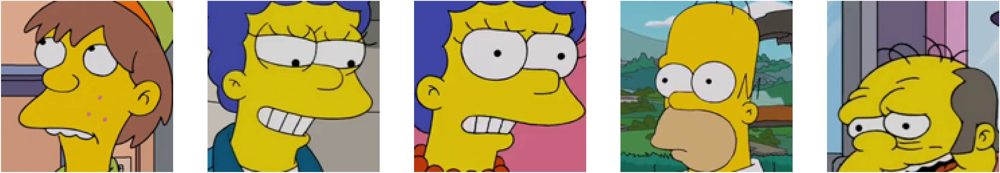

In [4]:
IMAGE_SIZE = 128
OUTPUT_DIR ="Simpson2"

def show_samples(sample_images,epoch):
    figure, axes = plt.subplots(1, len(sample_images), figsize = (IMAGE_SIZE, IMAGE_SIZE))
    for index, axis in enumerate(axes):
        axis.axis('off')
        image_array = sample_images[index]
        axis.imshow(image_array)
        image = Image.fromarray(image_array)
    plt.savefig(OUTPUT_DIR + "muestra_" + str(epoch) + ".JPG")
    plt.show()
    plt.close()
from glob import glob
import random

input_images = np.asarray([np.asarray(Image.open(file).resize((IMAGE_SIZE, IMAGE_SIZE))) 
                           for file in glob('Simpson/*')])

sample_images = random.sample(list(input_images), 5)
show_samples(sample_images,0)

# GENERADORA


In [5]:
def generator(z, output_channel_dim, training):
    with tf.variable_scope("generator", reuse= not training):
        
        # 8x8x1024
        fully_connected = tf.layers.dense(z, 8*8*1024)
        fully_connected = tf.reshape(fully_connected, (-1, 8, 8, 1024))
        fully_connected = tf.layers.batch_normalization(inputs = fully_connected,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="fully_connected")
        fully_connected = tf.nn.leaky_relu(fully_connected)

        # 8x8x1024 -> 16x16x512
        trans_conv1 = tf.layers.conv2d_transpose(inputs=fully_connected,
                                                 filters=512,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                                 name="trans_conv1")
        batch_trans_conv1 = tf.layers.batch_normalization(inputs = trans_conv1,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv1")
        trans_conv1_out = tf.nn.leaky_relu(batch_trans_conv1,
                                           name="trans_conv1_out")
        
        # 16x16x512 -> 32x32x256
        trans_conv2 = tf.layers.conv2d_transpose(inputs=trans_conv1_out,
                                                 filters=256,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                                 name="trans_conv2")
        batch_trans_conv2 = tf.layers.batch_normalization(inputs = trans_conv2,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv2")
        trans_conv2_out = tf.nn.leaky_relu(batch_trans_conv2,
                                           name="trans_conv2_out")
        
        # 32x32x256 -> 64x64x128
        trans_conv3 = tf.layers.conv2d_transpose(inputs=trans_conv2_out,
                                                 filters=128,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                                 name="trans_conv3")
        batch_trans_conv3 = tf.layers.batch_normalization(inputs = trans_conv3,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv3")
        trans_conv3_out = tf.nn.leaky_relu(batch_trans_conv3,
                                           name="trans_conv3_out")
        
        # 64x64x128 -> 128x128x64
        trans_conv4 = tf.layers.conv2d_transpose(inputs=trans_conv3_out,
                                                 filters=64,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                                 name="trans_conv4")
        batch_trans_conv4 = tf.layers.batch_normalization(inputs = trans_conv4,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv4")
        trans_conv4_out = tf.nn.leaky_relu(batch_trans_conv4,
                                           name="trans_conv4_out")
        
        # 128x128x64 -> 128x128x3
        logits = tf.layers.conv2d_transpose(inputs=trans_conv4_out,
                                            filters=3,
                                            kernel_size=[5,5],
                                            strides=[1,1],
                                            padding="SAME",
                                            kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                            name="logits")
        
        drop = tf.layers.dropout(logits,rate=0.5)
        out = tf.tanh(drop, name="out")
        return out

# DISCRIMINADORA

In [6]:
def discriminator(x, reuse):
    with tf.variable_scope("discriminator", reuse=reuse): 
        
        # 128*128*3 -> 64x64x64 
        conv1 = tf.layers.conv2d(inputs=x,
                                 filters=64,
                                 kernel_size=[5,5],
                                 strides=[2,2],
                                 padding="SAME",
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='conv1')
        batch_norm1 = tf.layers.batch_normalization(conv1,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm1')
        conv1_out = tf.nn.leaky_relu(batch_norm1,
                                     name="conv1_out")
        
        # 64x64x64-> 32x32x128 
        conv2 = tf.layers.conv2d(inputs=conv1_out,
                                 filters=128,
                                 kernel_size=[5, 5],
                                 strides=[2, 2],
                                 padding="SAME",
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='conv2')
        batch_norm2 = tf.layers.batch_normalization(conv2,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm2')
        conv2_out = tf.nn.leaky_relu(batch_norm2,
                                     name="conv2_out")
        
        # 32x32x128 -> 16x16x256  
        conv3 = tf.layers.conv2d(inputs=conv2_out,
                                 filters=256,
                                 kernel_size=[5, 5],
                                 strides=[2, 2],
                                 padding="SAME",
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='conv3')
        batch_norm3 = tf.layers.batch_normalization(conv3,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm3')
        conv3_out = tf.nn.leaky_relu(batch_norm3,
                                     name="conv3_out")
        
        # 16x16x256 -> 16x16x512
        conv4 = tf.layers.conv2d(inputs=conv3_out,
                                 filters=512,
                                 kernel_size=[5, 5],
                                 strides=[1, 1],
                                 padding="SAME",
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='conv4')
        batch_norm4 = tf.layers.batch_normalization(conv4,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm4')
        conv4_out = tf.nn.leaky_relu(batch_norm4,
                                     name="conv4_out")
        
        # 16x16x512 -> 8x8x1024
        conv5 = tf.layers.conv2d(inputs=conv4_out,
                                filters=1024,
                                kernel_size=[5, 5],
                                strides=[2, 2],
                                padding="SAME",
                                kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                name='conv5')
        batch_norm5 = tf.layers.batch_normalization(conv5,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm5')
        conv5_out = tf.nn.leaky_relu(batch_norm5,
                                     name="conv5_out")

        #flatten = tf.layers.dropout(conv5_out,rate=0.2) ####
        flatten = tf.reshape(conv5_out, (-1, 8*8*1024))
        logits = tf.layers.dense(inputs=flatten,
                                 units=1,
                                 activation=None)
        out = tf.sigmoid(logits)
        return out, logits

# LOSS

In [7]:
def model_loss(input_real, input_z, output_channel_dim, EPOCA):
    g_model = generator(input_z, output_channel_dim, True)

    noisy_input_real = input_real + tf.random_normal(shape=tf.shape(input_real),
                                                     mean=0.0,
                                                     stddev=random.uniform(0.0, 0.1),#/EPOCA,
                                                     dtype=tf.float32)
    
    d_model_real, d_logits_real = discriminator(noisy_input_real, reuse=False)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)

    if EPOCA % 10 == 0:
      labels_fake = tf.ones_like(d_model_real)*random.uniform(0.9, 1.0)
      labels_real = tf.zeros_like(d_model_fake)+random.uniform(0, 0.1)
    else:
      labels_real = tf.ones_like(d_model_real)*random.uniform(0.9, 1.0)
      labels_fake = tf.zeros_like(d_model_fake)+random.uniform(0, 0.1)
    
    d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real,
                                                                         labels=labels_real))
    d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                                         labels=labels_fake))
    d_loss = tf.reduce_mean(0.5 * (d_loss_real + d_loss_fake))
    g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                                    labels=tf.ones_like(d_model_fake)))
    
    #checkpoint_dir = './training_checkpoints'
    #checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
    #checkpoint = tf.train.Checkpoint(generator_optimizer=gopt,
    #                             discriminator_optimizer=dopt,
    #                             generator=generator,
    #                             discriminator=discriminator)

    return d_loss, g_loss#, checkpoint

# OPTIMIZADOR

In [8]:
def model_optimizers(d_loss, g_loss):
    t_vars = tf.trainable_variables()
    g_vars = [var for var in t_vars if var.name.startswith("generator")]
    d_vars = [var for var in t_vars if var.name.startswith("discriminator")]
    
    update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    gen_updates = [op for op in update_ops if op.name.startswith('generator')]
    
    with tf.control_dependencies(gen_updates):
        d_train_opt = tf.train.AdamOptimizer(learning_rate=LR_D, beta1=BETA1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate=LR_G, beta1=BETA1).minimize(g_loss, var_list=g_vars)  
    return d_train_opt, g_train_opt

#-----------------------------------------------------------------------------------------------------

def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='inputs_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name="input_z")
    learning_rate_G = tf.placeholder(tf.float32, name="lr_g")
    learning_rate_D = tf.placeholder(tf.float32, name="lr_d")
    EPOCA_m = tf.placeholder(tf.float32, name="EPOCH")
    return inputs_real, inputs_z, learning_rate_G, learning_rate_D, EPOCA_m

#-----------------------------------------------------------------------------------------------------

def test(sess, input_z, out_channel_dim, epoch):
    example_z = np.random.normal(0, 0.3, size=[SAMPLES_TO_SHOW, input_z.get_shape().as_list()[-1]])
    samples = sess.run(generator(input_z, out_channel_dim, False), feed_dict={input_z: example_z})
    sample_images = [((sample + 1.0) * 127.5).astype(np.uint8) for sample in samples]
    show_samples(sample_images,epoch)

#-----------------------------------------------------------------------------------------------------

def summarize_epoch(epoch, duration, sess, d_losses, g_losses, input_z, data_shape):
    minibatch_size = int(data_shape[0]//BATCH_SIZE)
    print("Epoch {}/{}".format(epoch, EPOCHS),
          "\nDuration: {:.5f}".format(duration),
          "\nD Loss: {:.5f}".format(np.mean(d_losses[-minibatch_size:])),
          "\nG Loss: {:.5f}".format(np.mean(g_losses[-minibatch_size:])))

    fig, ax = plt.subplots()
    plt.plot(d_losses, label='Discriminator', alpha=0.6)
    plt.plot(g_losses, label='Generator', alpha=0.6)
    plt.title("Losses")
    plt.legend()
    plt.savefig(OUTPUT_DIR + "losses_" + str(epoch) + ".JPG")
    #plt.show()
    plt.close()
    test(sess, input_z, data_shape[3], epoch)

#-----------------------------------------------------------------------------------------------------

def get_batches(data):
    batches = []
    for i in range(int(data.shape[0]//BATCH_SIZE)):
        batch = data[i * BATCH_SIZE:(i + 1) * BATCH_SIZE]
        augmented_images = []
        for img in batch:
            image = Image.fromarray(img)
            if random.choice([True, False]):
                image = image.transpose(Image.FLIP_LEFT_RIGHT)
            augmented_images.append(np.asarray(image))
        batch = np.asarray(augmented_images)
        normalized_batch = (batch / 127.5) - 1.0
        batches.append(normalized_batch)
    return batches

# ENTRENAMIENTO

In [9]:
#from keras.callbacks import ModelCheckpoint

#filepath = 'my_best_model.epoch{epoch:02d}-lossD{d_losses:.2f}-loss{g_losses:.2f}.hdf5'

def train(get_batches, data_shape, checkpoint_to_load=None):
    input_images, input_z, lr_G, lr_D, epoca = model_inputs(data_shape[1:], NOISE_SIZE)
    d_loss, g_loss = model_loss(input_images, input_z, data_shape[3], epoca)
    d_opt, g_opt = model_optimizers(d_loss, g_loss)
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        epoch = 0
        iteration = 0
        d_losses = []
        g_losses = []
        
        for epoch in range(EPOCHS):        
            epoch += 1
            start_time = time.time()

            for batch_images in get_batches:
                iteration += 1
                batch_z = np.random.normal(0, 0.3, size=(BATCH_SIZE, NOISE_SIZE))
                _ = sess.run(d_opt, feed_dict={input_images: batch_images, input_z: batch_z, lr_D: LR_D})
                _ = sess.run(g_opt, feed_dict={input_images: batch_images, input_z: batch_z, lr_G: LR_G})
                d_losses.append(d_loss.eval({input_z: batch_z, input_images: batch_images, epoca: epoch}))
                g_losses.append(g_loss.eval({input_z: batch_z, epoca: epoch}))
                #checkpoint = ModelCheckpoint(filepath=filepath, 
                #             monitor=["d_losses","g_losses"],
                #             verbose=1)

            summarize_epoch(epoch, time.time()-start_time, sess, d_losses, g_losses, input_z, data_shape)

#-----------------------------------------------------------------------------------------------------

# Paths
#INPUT_DATA_DIR = ""
# OUTPUT_DIR = './{date:%Y-%m-%d_%H:%M:%S}/'.format(date=datetime.datetime.now())
# if not os.path.exists(OUTPUT_DIR):
#     os.makedirs(OUTPUT_DIR)

# HIPERPARÁMETROS Y CORRER

In [10]:
# Hyperparameters
IMAGE_SIZE = 128
NOISE_SIZE = 100
LR_D = 0.00005
LR_G = 0.00005
BATCH_SIZE = 64
EPOCHS = 100 # For better results increase this value 
BETA1 = 0.5
WEIGHT_INIT_STDDEV = 0.02
EPSILON = 0.00005
SAMPLES_TO_SHOW = 5

Start!
Input: (9877, 128, 128, 3)
Instructions for updating:
Colocations handled automatically by placer.


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/legacy_tf_layers/core.py:171: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  warnings.warn('`tf.layers.dense` is deprecated and '
/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/base_layer_v1.py:1692: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  warnings.warn('`layer.apply` is deprecated and '
/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/legacy_tf_layers/normalization.py:308: UserWarning: `tf.layers.batch_normalization` is deprecated and will be removed in a future version. Please use `tf.keras.layers.BatchNormalization` instead. In particular, `tf.control_dependencies(tf.GraphKeys.UPDATE_OPS)` should not be used (consult the `tf.keras.layers.BatchNormalization` documentation).
  '`tf.layers.batch_normalization` is depr

Epoch 1/100 
Duration: 302.22405 
D Loss: 0.76164 
G Loss: 2.56991


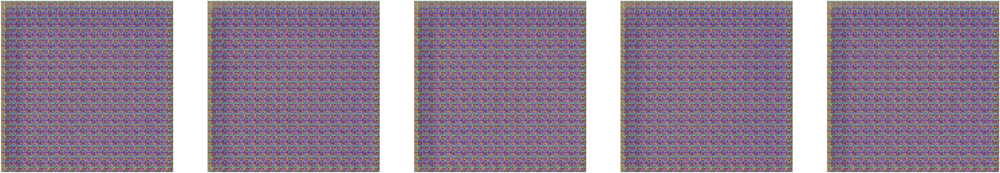

Epoch 2/100 
Duration: 272.09507 
D Loss: 0.40862 
G Loss: 2.51947


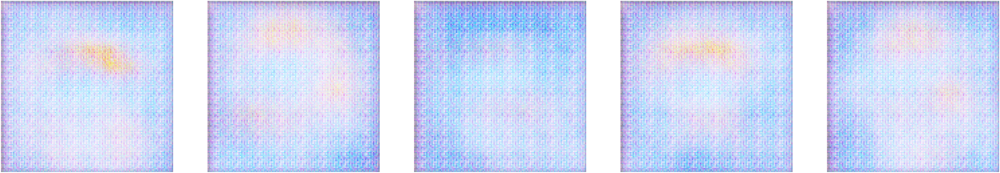

Epoch 3/100 
Duration: 272.34610 
D Loss: 0.36922 
G Loss: 2.09267


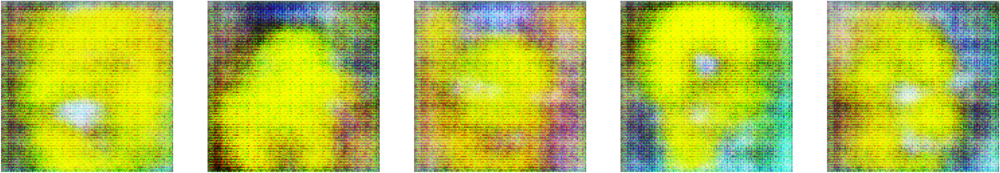

Epoch 4/100 
Duration: 272.18160 
D Loss: 0.37776 
G Loss: 1.84438


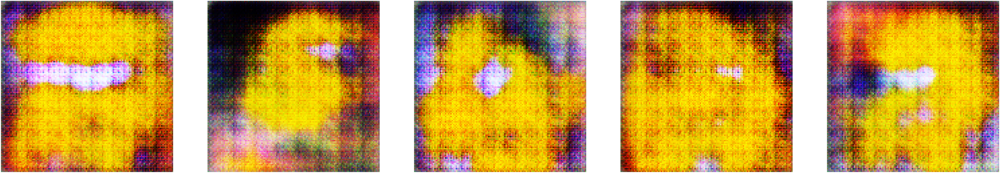

Epoch 5/100 
Duration: 273.16035 
D Loss: 0.40322 
G Loss: 1.83830


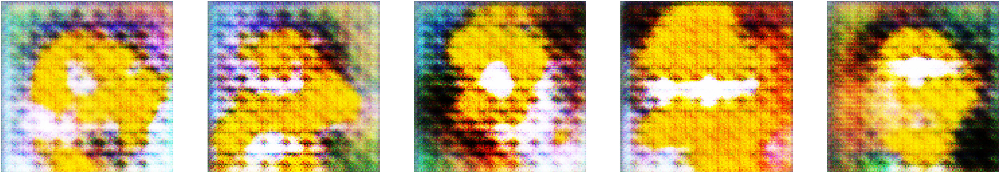

Epoch 6/100 
Duration: 272.37505 
D Loss: 0.40478 
G Loss: 1.71889


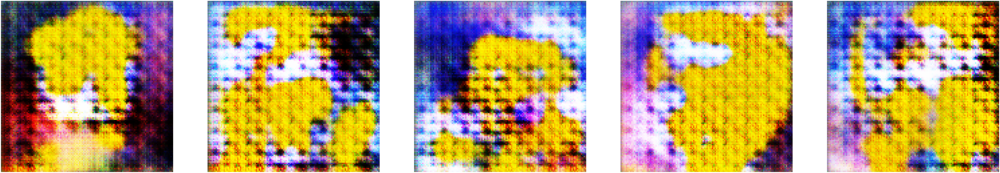

Epoch 7/100 
Duration: 272.34870 
D Loss: 0.43807 
G Loss: 1.72027


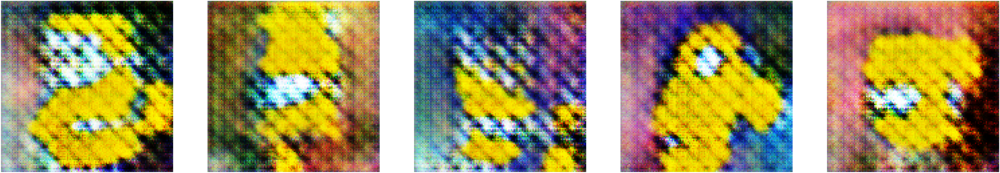

Epoch 8/100 
Duration: 272.77656 
D Loss: 0.41750 
G Loss: 1.66414


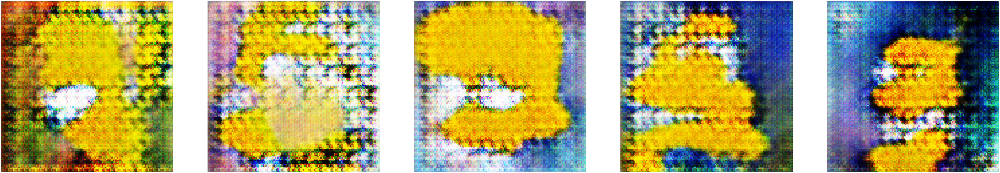

Epoch 9/100 
Duration: 272.42292 
D Loss: 0.40846 
G Loss: 1.68447


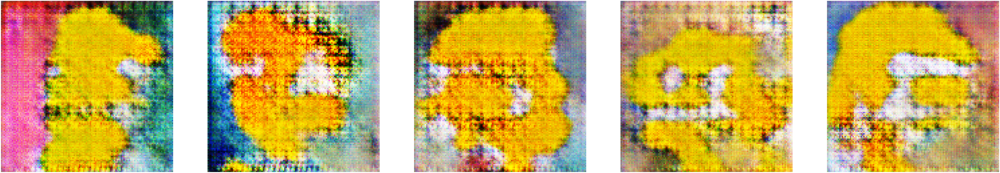

Epoch 10/100 
Duration: 272.56063 
D Loss: 0.39472 
G Loss: 1.67339


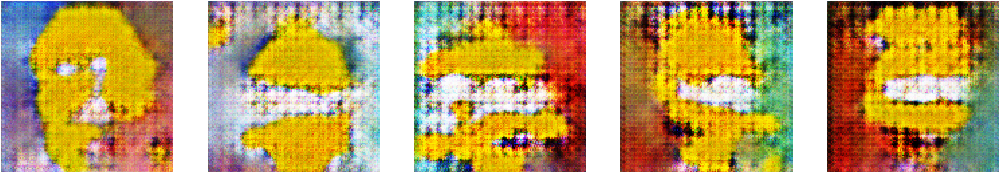

Epoch 11/100 
Duration: 272.40955 
D Loss: 0.39150 
G Loss: 1.69697


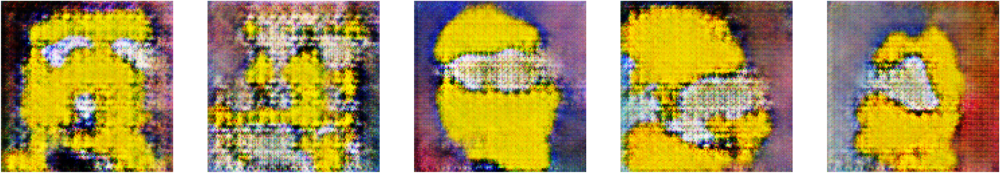

Epoch 12/100 
Duration: 272.71584 
D Loss: 0.40314 
G Loss: 1.67881


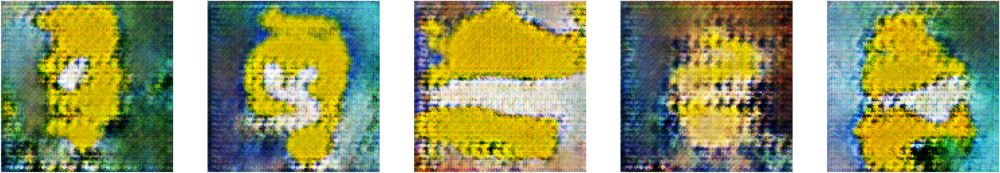

Epoch 13/100 
Duration: 272.32471 
D Loss: 0.36362 
G Loss: 1.67975


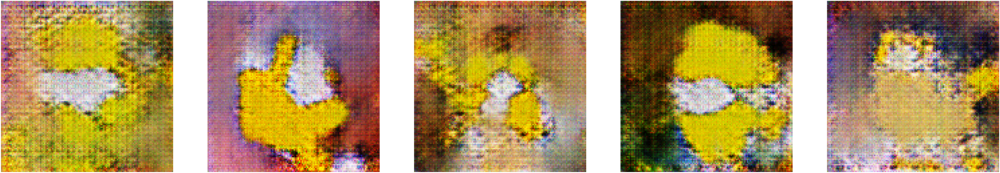

Epoch 14/100 
Duration: 272.38337 
D Loss: 0.39383 
G Loss: 1.63567


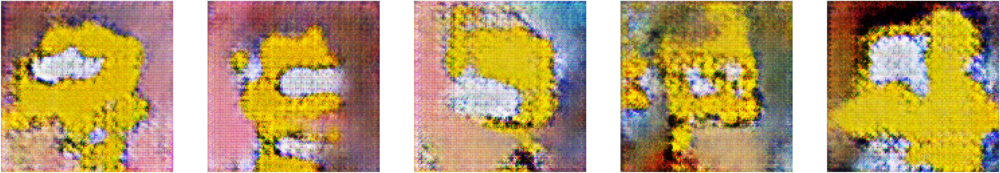

Epoch 15/100 
Duration: 272.56996 
D Loss: 0.39758 
G Loss: 1.57424


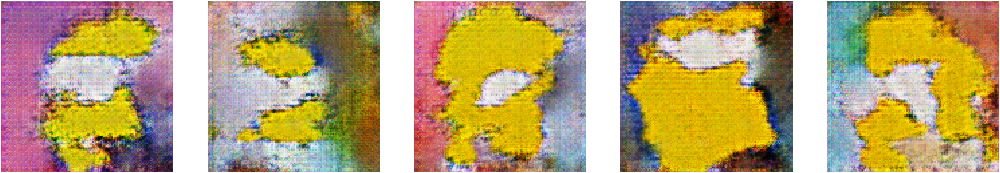

Epoch 16/100 
Duration: 272.32780 
D Loss: 0.38967 
G Loss: 1.56899


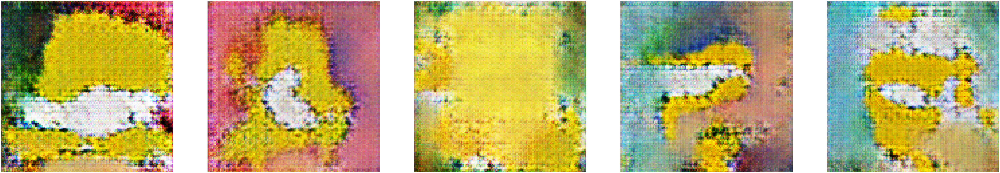

Epoch 17/100 
Duration: 272.49933 
D Loss: 0.39186 
G Loss: 1.56028


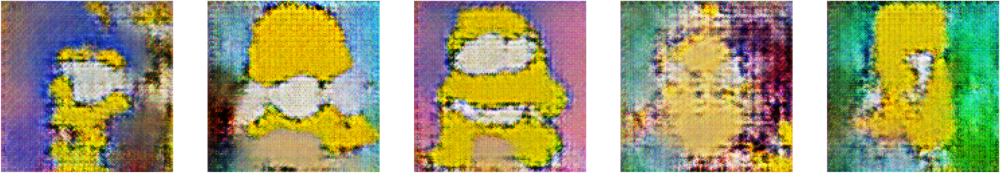

Epoch 18/100 
Duration: 272.56068 
D Loss: 0.39305 
G Loss: 1.57447


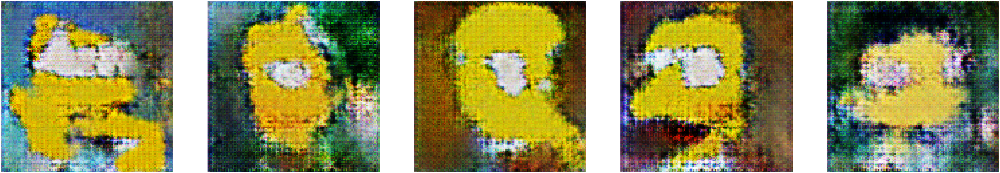

Epoch 19/100 
Duration: 272.40239 
D Loss: 0.39340 
G Loss: 1.58384


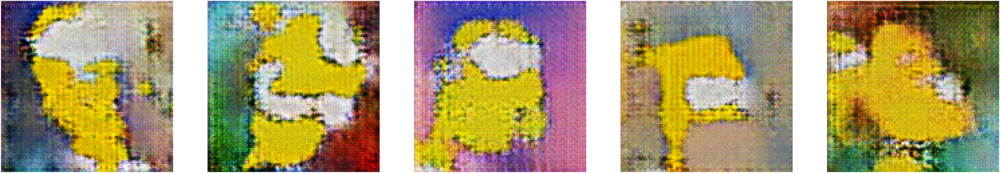

Epoch 20/100 
Duration: 272.45355 
D Loss: 0.37588 
G Loss: 1.54381


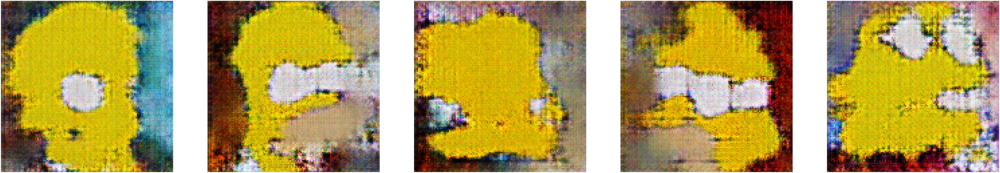

Epoch 21/100 
Duration: 272.36095 
D Loss: 0.38647 
G Loss: 1.59444


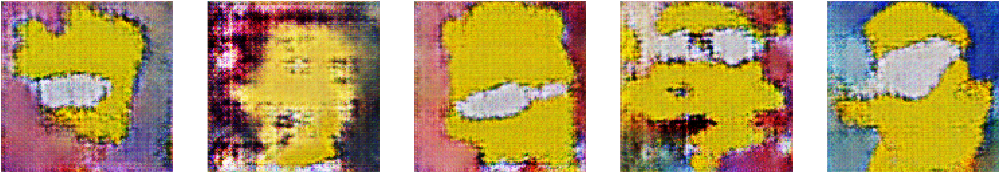

Epoch 22/100 
Duration: 272.46163 
D Loss: 0.38315 
G Loss: 1.64963


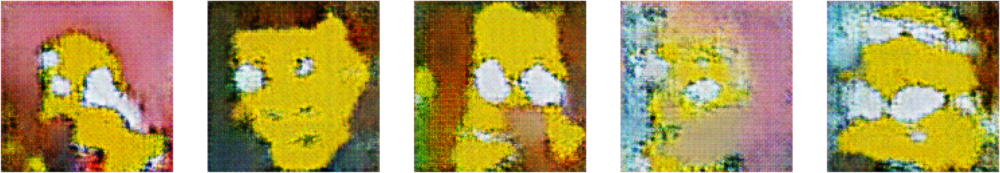

Epoch 23/100 
Duration: 272.50609 
D Loss: 0.36761 
G Loss: 1.60468


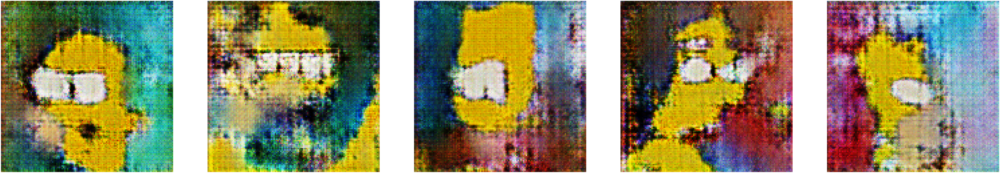

Epoch 24/100 
Duration: 272.29663 
D Loss: 0.37094 
G Loss: 1.66761


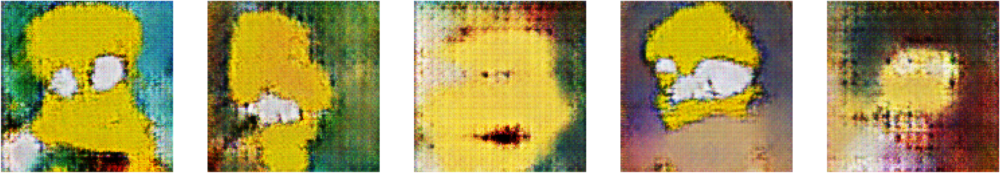

Epoch 25/100 
Duration: 272.30520 
D Loss: 0.35545 
G Loss: 1.68536


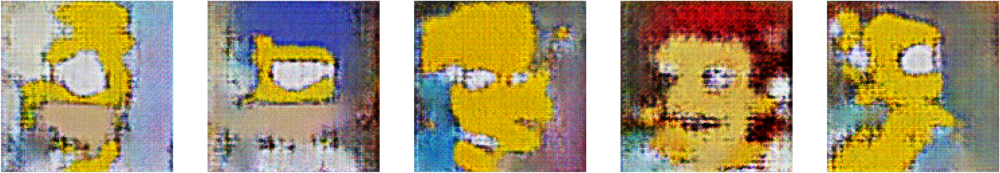

Epoch 26/100 
Duration: 272.21705 
D Loss: 0.34087 
G Loss: 1.67569


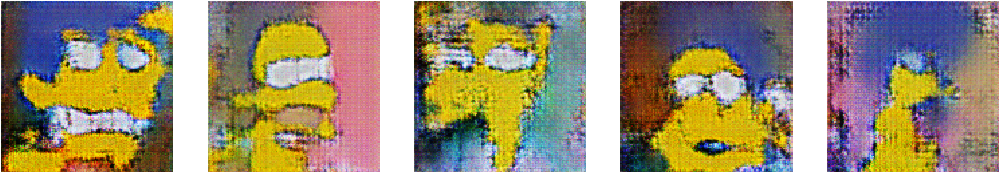

Epoch 27/100 
Duration: 272.33237 
D Loss: 0.37296 
G Loss: 1.70750


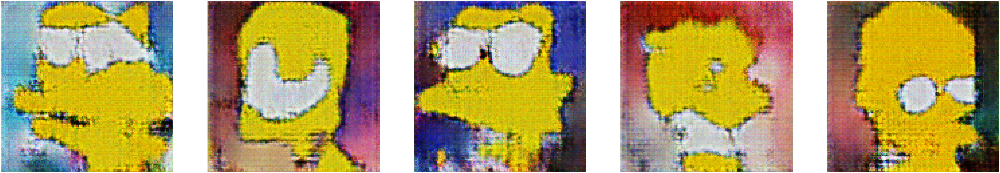

Epoch 28/100 
Duration: 272.17058 
D Loss: 0.35301 
G Loss: 1.68467


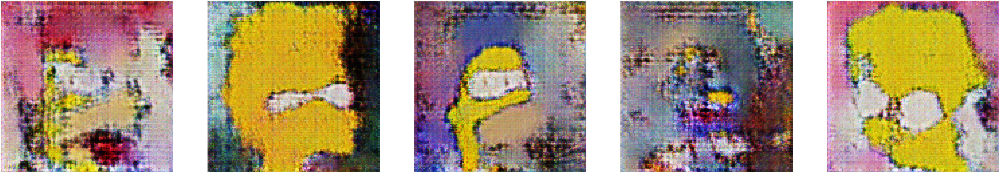

Epoch 29/100 
Duration: 271.49474 
D Loss: 0.36869 
G Loss: 1.75866


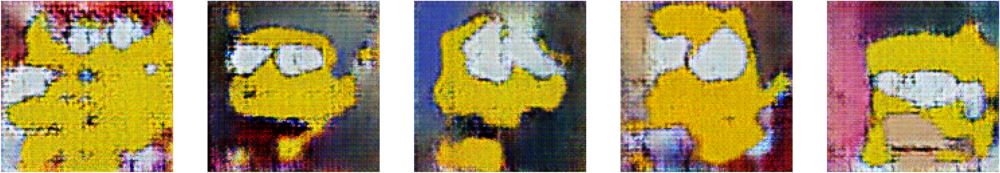

Epoch 30/100 
Duration: 272.35242 
D Loss: 0.33799 
G Loss: 1.68048


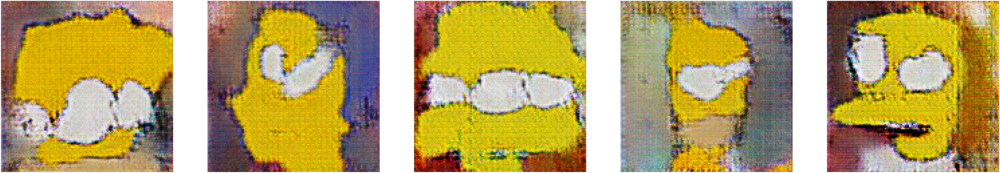

Epoch 31/100 
Duration: 272.76721 
D Loss: 0.32593 
G Loss: 1.67949


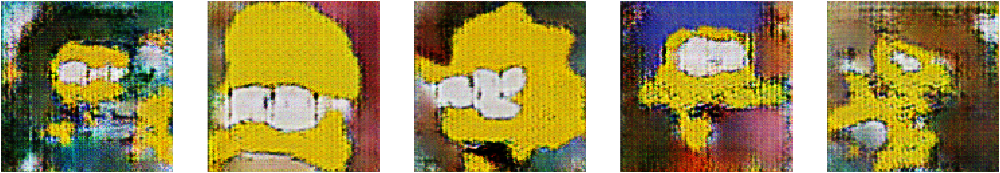

Epoch 32/100 
Duration: 272.30512 
D Loss: 0.36037 
G Loss: 1.76897


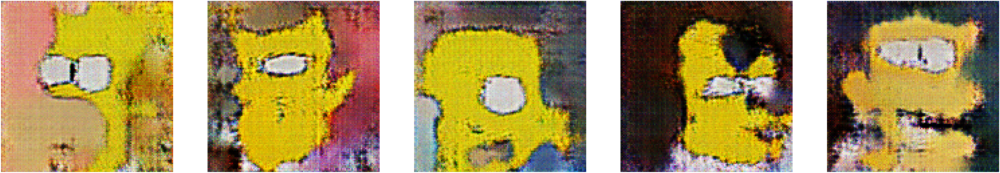

Epoch 33/100 
Duration: 272.08299 
D Loss: 0.35183 
G Loss: 1.72928


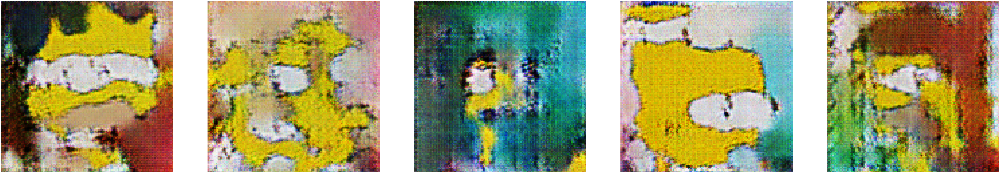

Epoch 34/100 
Duration: 272.43050 
D Loss: 0.33812 
G Loss: 1.78786


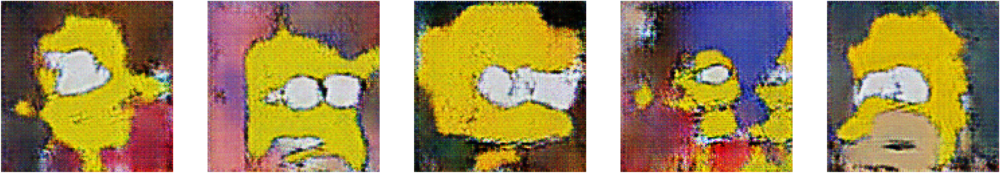

Epoch 35/100 
Duration: 272.43330 
D Loss: 0.36875 
G Loss: 1.80531


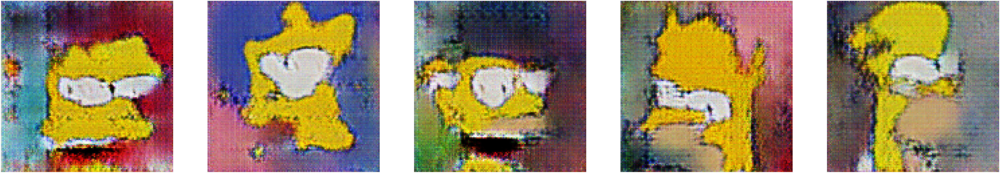

Epoch 36/100 
Duration: 272.20205 
D Loss: 0.30900 
G Loss: 1.71743


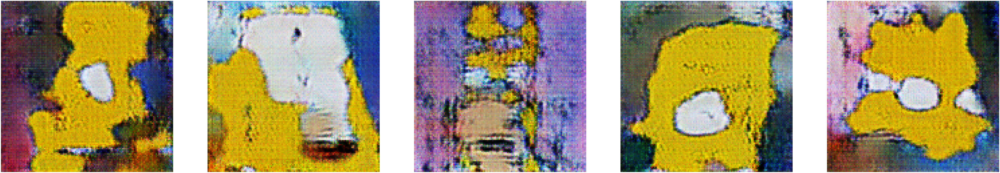

Epoch 37/100 
Duration: 272.56434 
D Loss: 0.30903 
G Loss: 1.72440


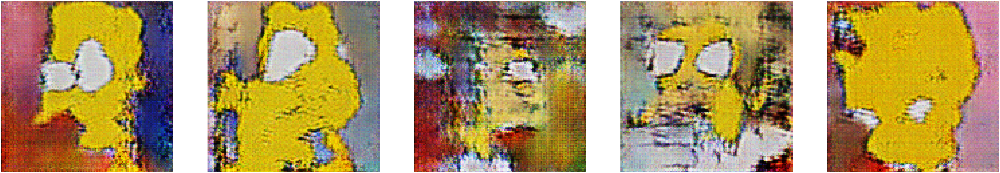

Epoch 38/100 
Duration: 272.23587 
D Loss: 0.45564 
G Loss: 1.85579


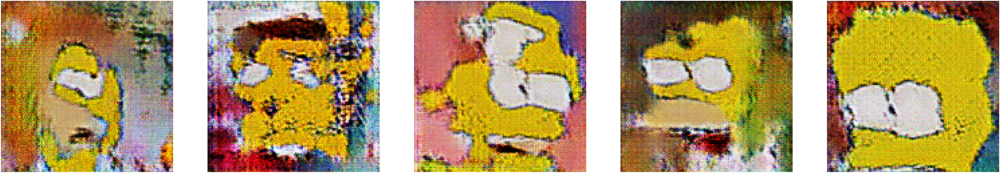

Epoch 39/100 
Duration: 272.42179 
D Loss: 0.29630 
G Loss: 1.70249


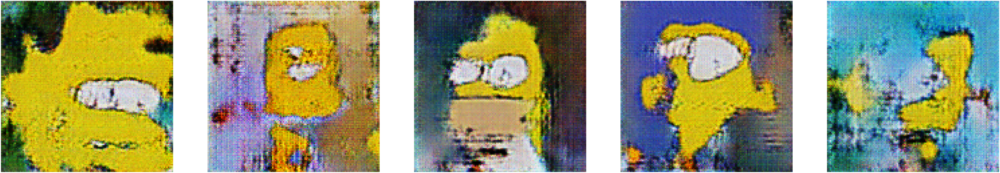

Epoch 40/100 
Duration: 272.46797 
D Loss: 0.34519 
G Loss: 1.78442


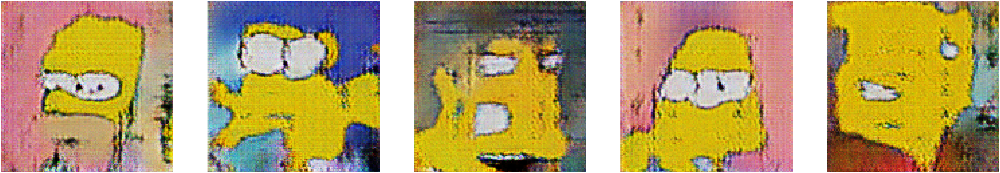

Epoch 41/100 
Duration: 272.44259 
D Loss: 0.28736 
G Loss: 1.72599


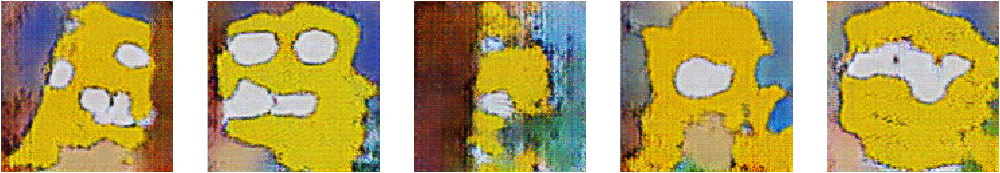

Epoch 42/100 
Duration: 272.37767 
D Loss: 0.37718 
G Loss: 1.81342


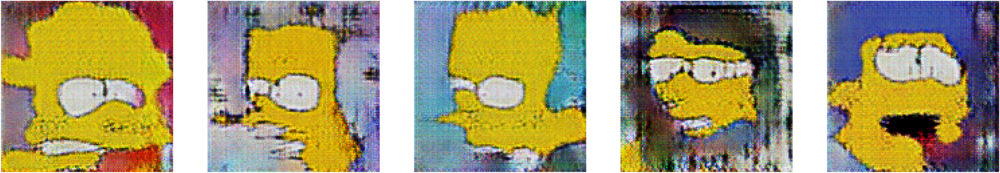

Epoch 43/100 
Duration: 272.40546 
D Loss: 0.29461 
G Loss: 1.70902


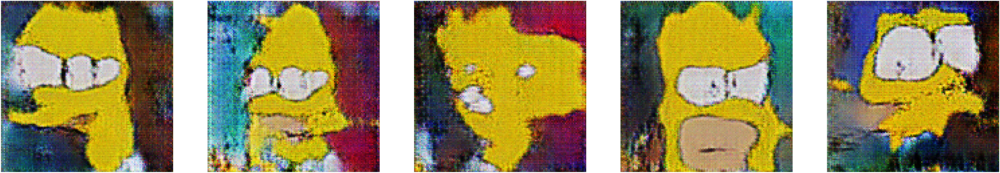

Epoch 44/100 
Duration: 271.48012 
D Loss: 0.28478 
G Loss: 1.71685


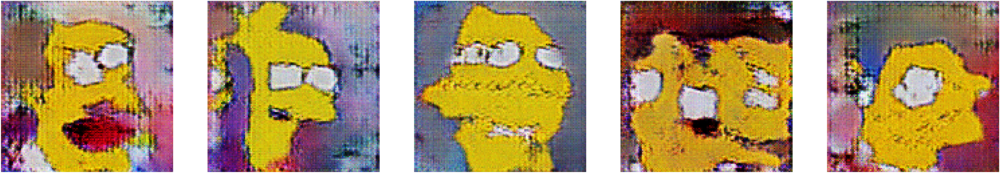

Epoch 45/100 
Duration: 271.84144 
D Loss: 0.30898 
G Loss: 1.77200


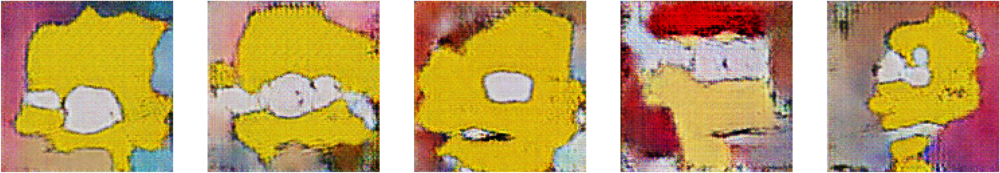

Epoch 46/100 
Duration: 271.57422 
D Loss: 0.41572 
G Loss: 1.92835


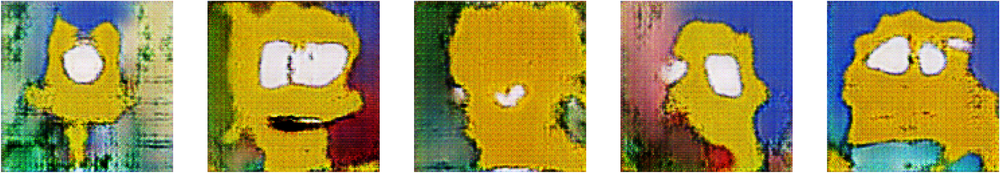

Epoch 47/100 
Duration: 271.71816 
D Loss: 0.32098 
G Loss: 1.68561


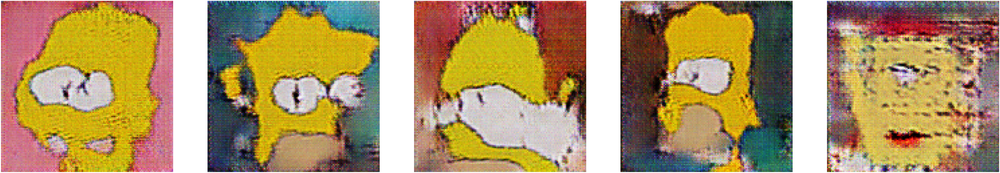

Epoch 48/100 
Duration: 272.21544 
D Loss: 0.27448 
G Loss: 1.74618


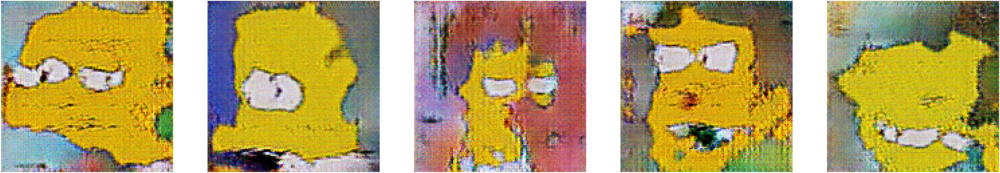

Epoch 49/100 
Duration: 272.29957 
D Loss: 0.28536 
G Loss: 1.81816


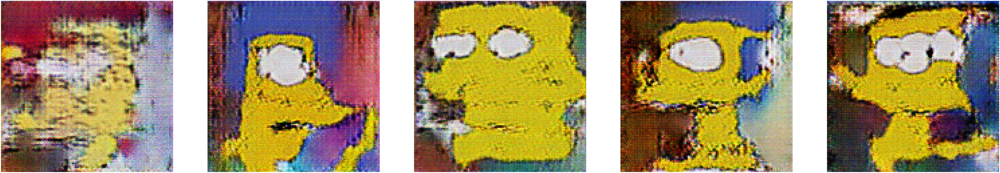

Epoch 50/100 
Duration: 272.51955 
D Loss: 0.41313 
G Loss: 1.89314


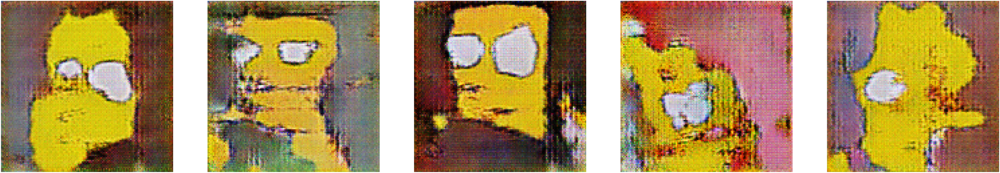

Epoch 51/100 
Duration: 272.42544 
D Loss: 0.31740 
G Loss: 1.68707


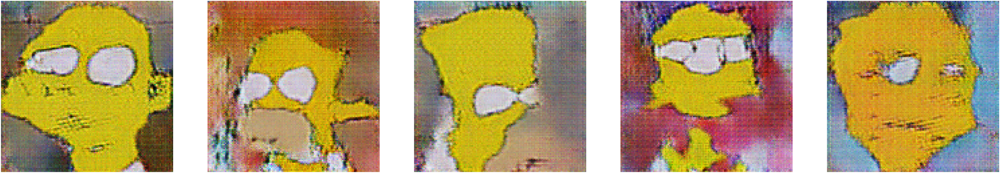

Epoch 52/100 
Duration: 272.36210 
D Loss: 0.26731 
G Loss: 1.70039


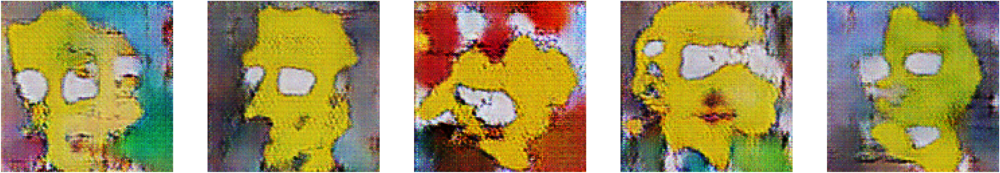

Epoch 53/100 
Duration: 272.56472 
D Loss: 0.27056 
G Loss: 1.79429


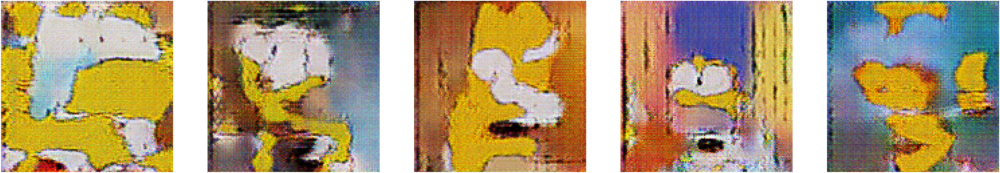

Epoch 54/100 
Duration: 271.89315 
D Loss: 0.36422 
G Loss: 2.03952


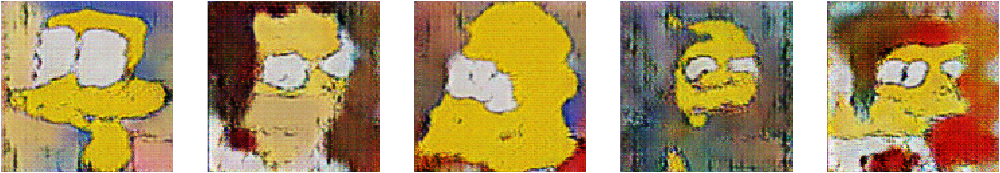

Epoch 55/100 
Duration: 272.07742 
D Loss: 0.27210 
G Loss: 1.71520


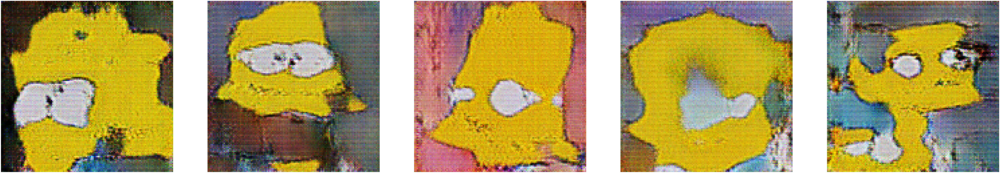

Epoch 56/100 
Duration: 271.41438 
D Loss: 0.34439 
G Loss: 1.81470


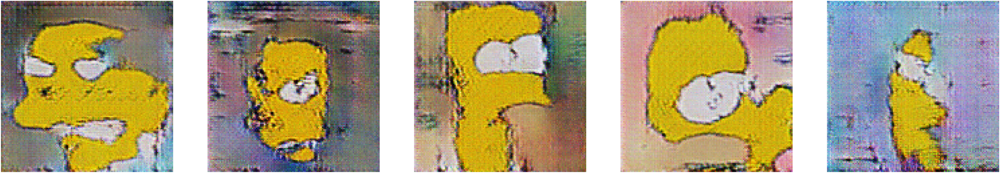

Epoch 57/100 
Duration: 270.64932 
D Loss: 0.26017 
G Loss: 1.77281


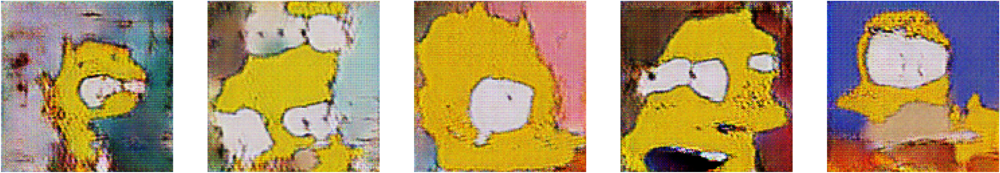

Epoch 58/100 
Duration: 270.10844 
D Loss: 0.27051 
G Loss: 1.76538


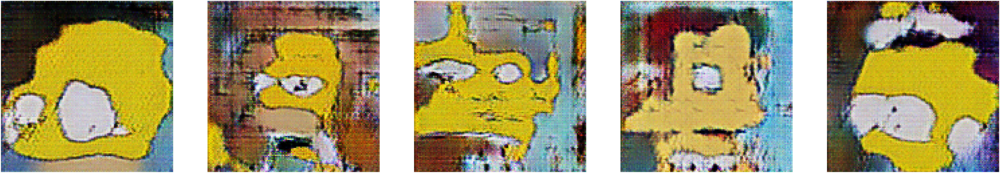

Epoch 59/100 
Duration: 269.15990 
D Loss: 0.30220 
G Loss: 1.85842


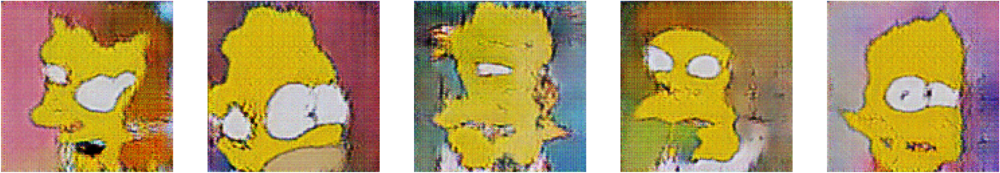

Epoch 60/100 
Duration: 270.55283 
D Loss: 0.27015 
G Loss: 1.75893


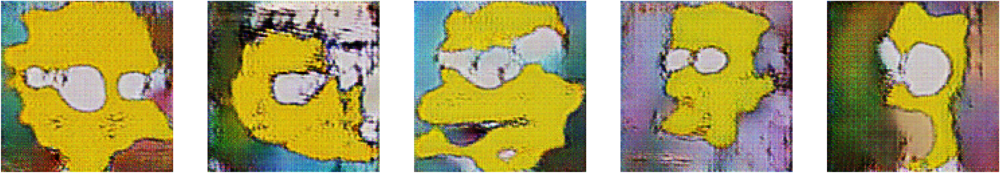

Epoch 61/100 
Duration: 270.90766 
D Loss: 0.46853 
G Loss: 1.86553


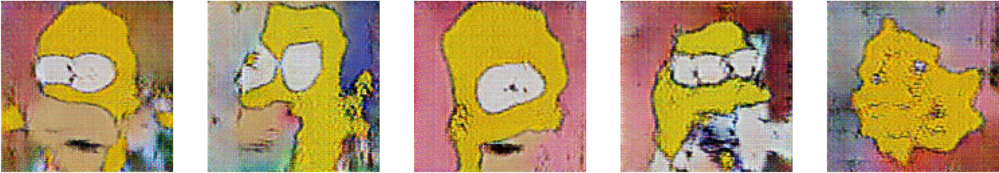

Epoch 62/100 
Duration: 270.49560 
D Loss: 0.26460 
G Loss: 1.74664


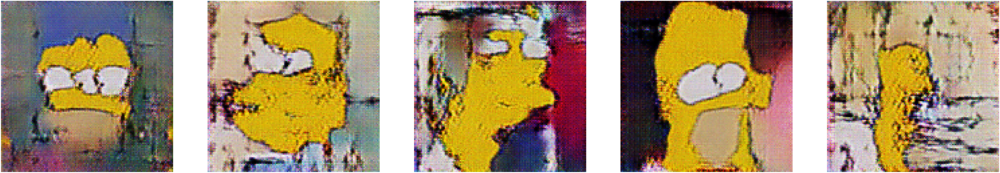

Epoch 63/100 
Duration: 270.53407 
D Loss: 0.25762 
G Loss: 1.76117


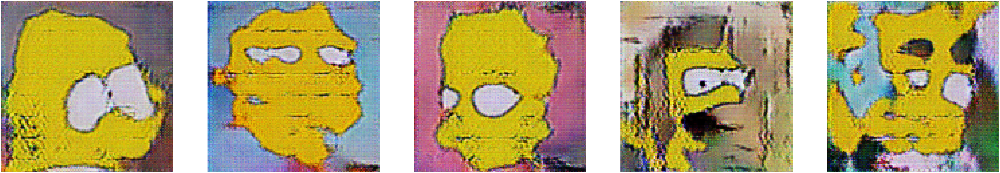

Epoch 64/100 
Duration: 270.46154 
D Loss: 0.40211 
G Loss: 1.89092


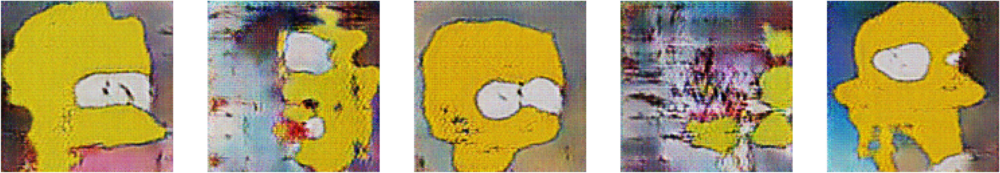

Epoch 65/100 
Duration: 269.43415 
D Loss: 0.26279 
G Loss: 1.75231


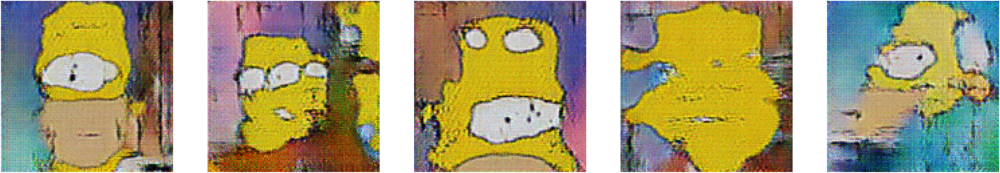

Epoch 66/100 
Duration: 270.03409 
D Loss: 0.25839 
G Loss: 1.77201


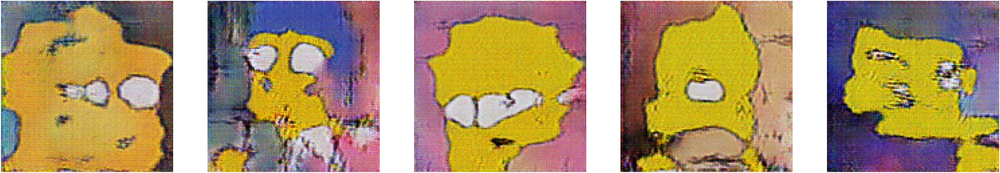

Epoch 67/100 
Duration: 269.81706 
D Loss: 0.26406 
G Loss: 1.78574


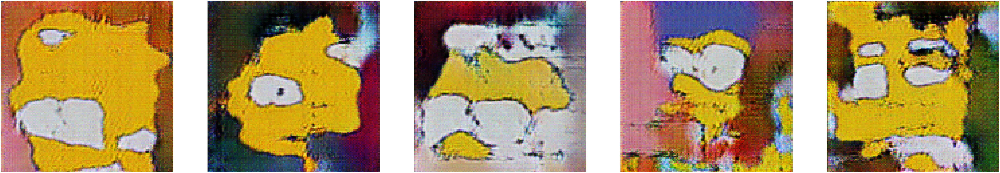

Epoch 68/100 
Duration: 270.87977 
D Loss: 0.40872 
G Loss: 1.91547


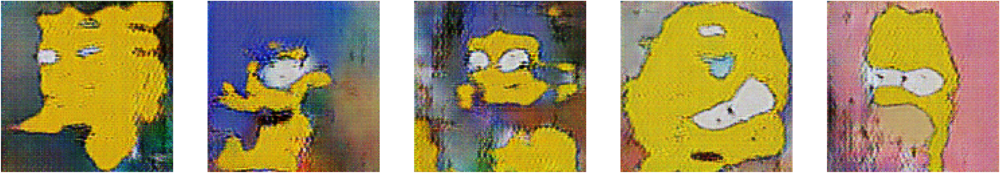

Epoch 69/100 
Duration: 270.71341 
D Loss: 0.26051 
G Loss: 1.74729


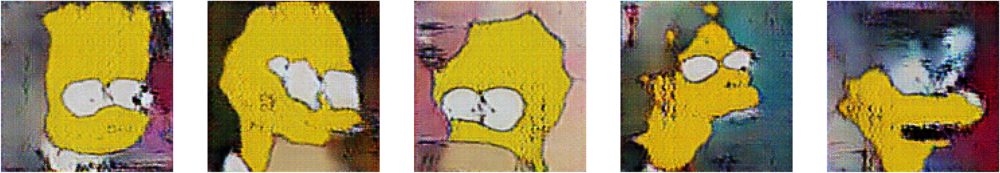

Epoch 70/100 
Duration: 270.41591 
D Loss: 0.25976 
G Loss: 1.79249


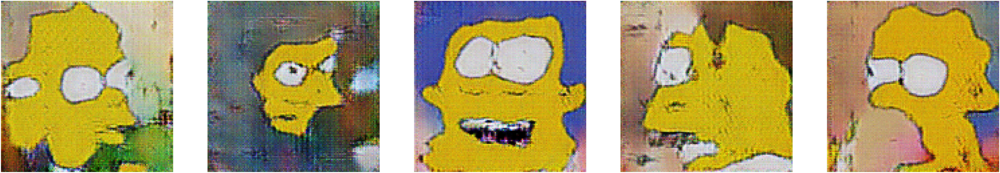

Epoch 71/100 
Duration: 270.19306 
D Loss: 0.25941 
G Loss: 1.79426


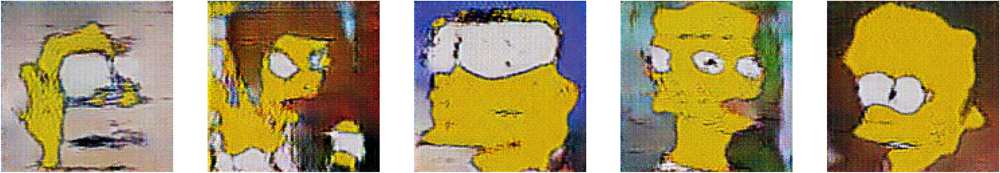

Epoch 72/100 
Duration: 269.93073 
D Loss: 0.36931 
G Loss: 1.85923


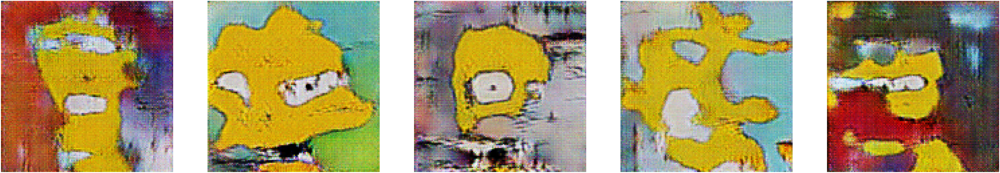

Epoch 73/100 
Duration: 269.88314 
D Loss: 0.26696 
G Loss: 1.78207


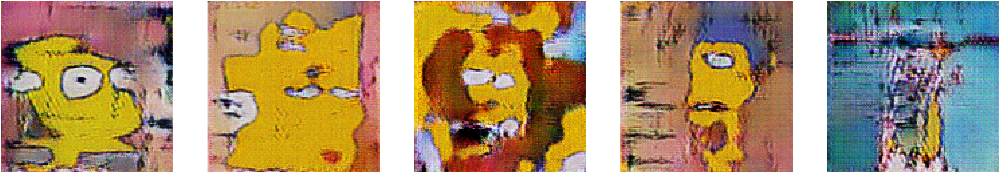

Epoch 74/100 
Duration: 270.93260 
D Loss: 0.27150 
G Loss: 1.78823


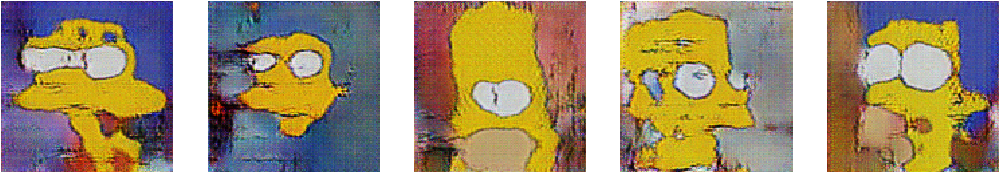

Epoch 75/100 
Duration: 270.36329 
D Loss: 0.25299 
G Loss: 1.78660


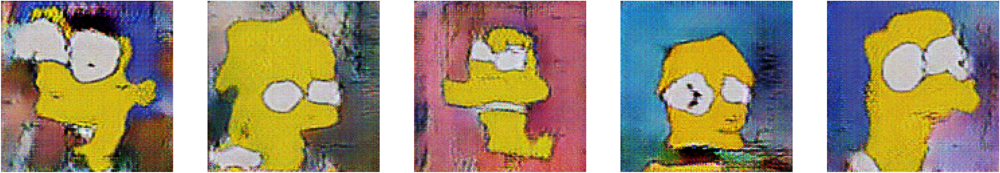

Epoch 76/100 
Duration: 270.67079 
D Loss: 0.28086 
G Loss: 1.82780


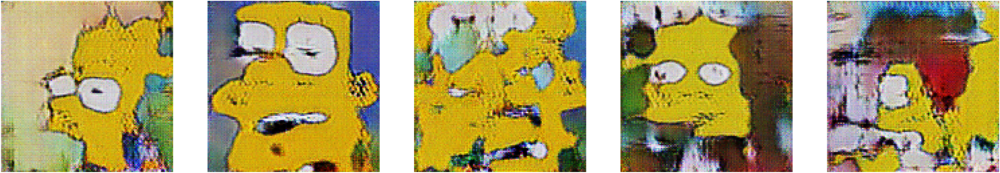

Epoch 77/100 
Duration: 270.15246 
D Loss: 0.43168 
G Loss: 1.97189


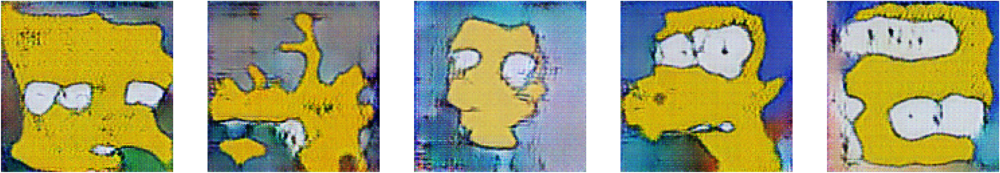

Epoch 78/100 
Duration: 270.03679 
D Loss: 0.30007 
G Loss: 1.71976


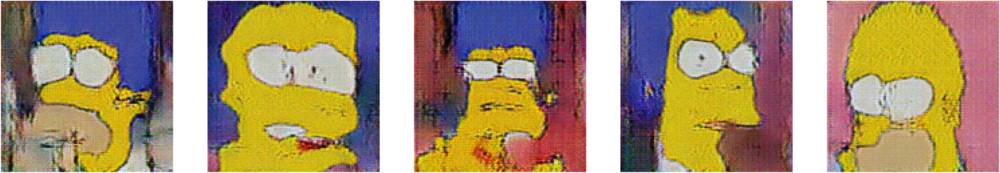

Epoch 79/100 
Duration: 269.87115 
D Loss: 0.24782 
G Loss: 1.75155


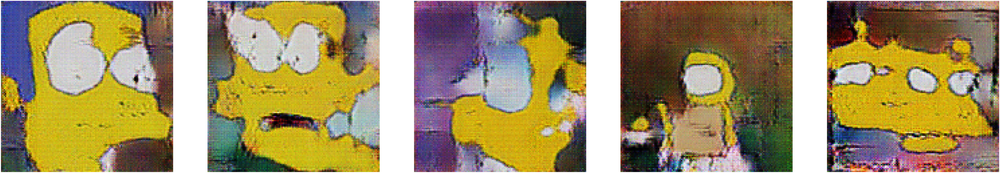

Epoch 80/100 
Duration: 270.34067 
D Loss: 0.24358 
G Loss: 1.80030


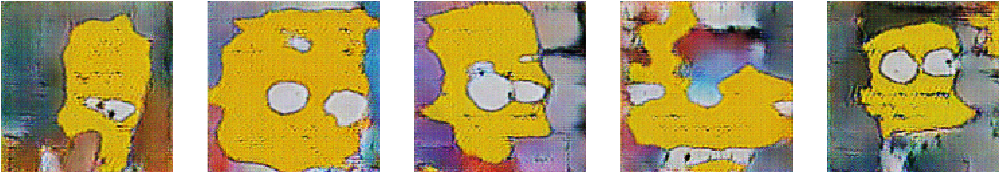

Epoch 81/100 
Duration: 270.66754 
D Loss: 0.25193 
G Loss: 1.81124


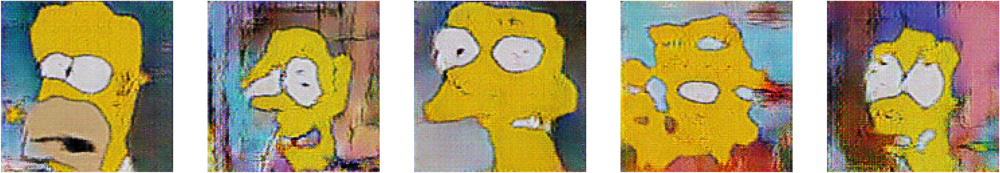

Epoch 82/100 
Duration: 270.29778 
D Loss: 0.46760 
G Loss: 2.03901


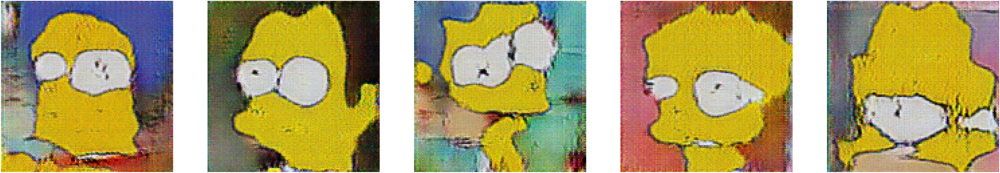

Epoch 83/100 
Duration: 269.90023 
D Loss: 0.25029 
G Loss: 1.73865


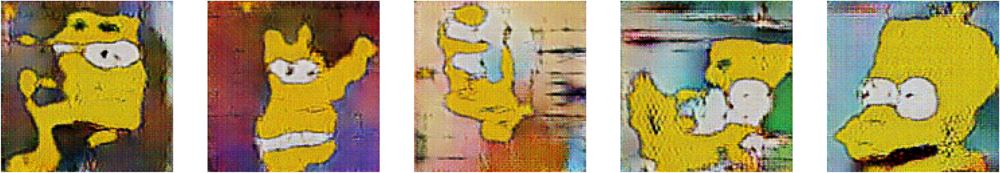

In [ ]:
# Training
print("Start!")
print ("Input: " + str(input_images.shape))

np.random.shuffle(input_images)
#tf.compat.v1.enable_eager_execution()
with tf.Graph().as_default():
    train(get_batches(input_images), input_images.shape)